In [1]:
## Notebook env: farnaz_spatial (farnaz_spatial kernel)
## this notebook quantifies and compares the frequency of each cell type across different regions and temperatures

In [ ]:
## look at written things to fix
## create objects for farnaz to easily manipulate (convert to R objects or simply take probability counts csv and attach to R Seurat loaded objects)
## send to farnaz so she can verify and adjust thresholds

In [1]:
import sys
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os
import seaborn as sns

In [2]:
results_folder = '/home/ssobti/projects/farnaz_spatial/output_data'

# create paths and names to results folders for reference regression and cell2location models
ref_run_name = f'{results_folder}/mouse/cell2location/multi_ref_annot/reference_signatures'
run_name = f'{results_folder}/mouse_late_2023/cell2location/multi_ref_annot/cell2location_map/N2_alpha20_cleaned_slides_v2'

adata_vis = sc.read_h5ad(f"{run_name}/sp_with_white_adipocytes.h5ad")

In [4]:
adata_vis.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,...,Mesothelium_binary,NK_cells_binary,Neutrophils_binary,Pericytes_binary,Schwan_cells_binary,Skeletal_muscle_binary,T_cells_binary,Tregs_binary,Vascular_smooth_muscle_binary,White_adipocytes_binary
spot_id,,,,,,,,,,,,,,,,,,,,,
B006_3_AACAATCCGAGTGGAC-1,1,103,47,B006_3,253,5.537334,281.0,5.641907,27.758007,45.551601,...,0,0,0,0,0,0,0,0,0,0
B006_3_AACAATGGAACCACAT-1,1,54,32,B006_3,822,6.712956,1059.0,6.966024,23.040604,31.822474,...,0,0,0,0,0,0,0,0,0,1
B006_3_AACAATGTGCTCCGAG-1,1,98,158,B006_3,1283,7.157735,1897.0,7.548556,21.349499,29.362151,...,0,0,0,0,0,0,0,0,0,0
B006_3_AACACCAGCCTACTCG-1,1,31,39,B006_3,872,6.771936,1134.0,7.034388,21.516755,30.335097,...,0,0,0,0,1,0,0,0,0,1
B006_3_AACACCGAGCTTGGAT-1,1,56,24,B006_3,565,6.338594,655.0,6.486161,21.374046,29.007634,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
B021_6_TGTTGGTGAGCGGACG-1,1,59,17,B021_6,986,6.894670,1143.0,7.042286,15.223097,22.484689,...,0,0,0,0,0,0,0,0,0,0
B021_6_TGTTGGTGCGCACGAG-1,1,24,108,B021_6,646,6.472346,817.0,6.706862,23.745410,33.170135,...,0,0,0,0,0,0,0,0,0,1
B021_6_TGTTGGTGCGCTTCGC-1,1,37,127,B021_6,859,6.756932,1184.0,7.077498,25.168919,33.614865,...,0,0,0,0,1,0,0,0,0,1


In [3]:
f"{run_name}/sp_with_white_adipocytes.h5ad"

'/home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/multi_ref_annot/cell2location_map/N2_alpha20_cleaned_slides_v2/sp_with_white_adipocytes.h5ad'

In [2]:
## load in the data

results_folder = '/home/ssobti/projects/farnaz_spatial/output_data'

# create paths and names to results folders for reference regression and cell2location models
ref_run_name = f'{results_folder}/mouse/cell2location/multi_ref_annot/reference_signatures'
run_name = f'{results_folder}/mouse_late_2023/cell2location/multi_ref_annot/cell2location_map/N2_alpha20_cleaned_slides_v2'

adata_file = f"{run_name}/sp.h5ad"
adata_vis = sc.read_h5ad(adata_file)
## adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_White_adipocytes'] = adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_Adipocytes'] - adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_Adipocytes']


In [3]:
adata_vis.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,mt_frac,_indices,_scvi_batch,_scvi_labels
spot_id,,,,,,,,,,,,,,,,
B006_3_AACAATCCGAGTGGAC-1,1,103,47,B006_3,253,5.537334,281.0,5.641907,27.758007,45.551601,81.138790,100.000000,0.0,0,0,0
B006_3_AACAATGGAACCACAT-1,1,54,32,B006_3,822,6.712956,1059.0,6.966024,23.040604,31.822474,41.265345,69.593957,0.0,1,0,0
B006_3_AACAATGTGCTCCGAG-1,1,98,158,B006_3,1283,7.157735,1897.0,7.548556,21.349499,29.362151,40.274117,58.724302,0.0,2,0,0
B006_3_AACACCAGCCTACTCG-1,1,31,39,B006_3,872,6.771936,1134.0,7.034388,21.516755,30.335097,40.740741,67.195767,0.0,3,0,0
B006_3_AACACCGAGCTTGGAT-1,1,56,24,B006_3,565,6.338594,655.0,6.486161,21.374046,29.007634,44.274809,90.076336,0.0,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
B021_6_TGTTGGTGAGCGGACG-1,1,59,17,B021_6,986,6.894670,1143.0,7.042286,15.223097,22.484689,31.233596,57.480315,0.0,44195,5,0
B021_6_TGTTGGTGCGCACGAG-1,1,24,108,B021_6,646,6.472346,817.0,6.706862,23.745410,33.170135,45.410037,82.129743,0.0,44196,5,0
B021_6_TGTTGGTGCGCTTCGC-1,1,37,127,B021_6,859,6.756932,1184.0,7.077498,25.168919,33.614865,44.341216,69.679054,0.0,44197,5,0


In [4]:
adata_vis.obsm['q05_cell_abundance_w_sf']

,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle
spot_id,,,,,,,,,,,,,,,,,,,
B006_3_AACAATCCGAGTGGAC-1,0.009526,0.025008,0.009148,0.069101,0.039000,0.007602,0.016945,0.013212,0.010591,0.006562,0.017726,0.005349,0.007072,0.006610,0.022778,0.008933,0.009566,0.008292,0.012450
B006_3_AACAATGGAACCACAT-1,0.033931,0.177042,0.015967,0.208581,0.048138,0.012286,0.014161,0.034113,0.031875,0.008932,0.029287,0.047869,0.032713,0.128522,0.041326,0.029770,0.036947,0.022930,0.052794
B006_3_AACAATGTGCTCCGAG-1,0.014720,0.074716,0.013440,0.404421,0.066136,0.100979,0.028151,0.016640,0.048720,0.013354,0.030991,0.011543,0.017948,0.025646,0.010668,0.019620,0.008751,0.014253,0.026380
B006_3_AACACCAGCCTACTCG-1,0.137516,0.094529,0.017102,0.185606,0.031837,0.206317,0.018226,0.046716,0.061760,0.043259,0.012945,0.012881,0.053909,0.047248,0.164719,0.020789,0.104820,0.015422,0.050161
B006_3_AACACCGAGCTTGGAT-1,0.079818,0.041578,0.023108,0.103648,0.095963,0.034016,0.016586,0.026241,0.007713,0.014608,0.030090,0.051466,0.012671,0.091653,0.018548,0.027187,0.020571,0.017267,0.027731
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
B021_6_TGTTGGTGAGCGGACG-1,0.159896,0.022041,0.044546,0.041064,0.028347,0.023758,0.037626,0.042115,0.108732,0.049487,0.044639,0.026816,0.021376,0.039300,0.028145,0.028595,0.092635,0.043291,0.056780
B021_6_TGTTGGTGCGCACGAG-1,0.057130,0.103666,0.020378,0.105073,0.160510,0.021513,0.016531,0.023823,0.026229,0.011019,0.015642,0.040838,0.011014,0.038702,0.026796,0.025315,0.017669,0.030063,0.054324
B021_6_TGTTGGTGCGCTTCGC-1,0.122339,0.113834,0.072811,0.184980,0.160002,0.014644,0.015585,0.028458,0.054070,0.011263,0.017258,0.034281,0.012180,0.089996,0.180438,0.012866,0.019993,0.017862,0.045113


In [5]:
### comparing cell type frequencies across slides using celltype thresholds
## for each cell type in a given slide, find the mean of the 95% quantile of spots in each slide, and set the threshold to be 50% of that mean
## count percent of cells that are above the threshold in each slide and compare across slides

In [6]:
upper_cut_cell_types = ['Neutrophils', 'Pericytes', 'Skeletal_muscle', 'T_cells', 'Tregs', 'Vascular_smooth_muscle', 'NK_cells', 'Mast_cells', 'Mesothelium', 'Macrophages', 'B_cells']
set(adata_vis.obsm['q05_cell_abundance_w_sf'].columns.str.replace('q05cell_abundance_w_sf_', '')).difference(set(upper_cut_cell_types))

{'Adipocyte_progenitors',
 'Adipocytes',
 'Brown_adipocytes',
 'Endothelial_cells',
 'Eosinophils',
 'Epithelial_cells',
 'Lymphatic_endothelial_cells',
 'Schwan_cells'}

In [7]:
deconvoluted_data = adata_vis.obsm['q05_cell_abundance_w_sf']
maxes = deconvoluted_data.quantile(0.99, axis = 0)
maxes3 = deconvoluted_data.quantile(0.95, axis = 0)

upper_cut_cell_types = ['Neutrophils', 'Pericytes', 'Skeletal_muscle', 'T_cells', 'Tregs', 'Vascular_smooth_muscle', 'NK_cells', 'Mast_cells', 'Mesothelium', 'Macrophages', 'B_cells']
final_maxes = [maxes[index] if name in upper_cut_cell_types else maxes3[index] for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''))]
names = [name for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''))]
## decrease adipocytes to 0.23, macrophages to 0.25?, increase epithelial cells to 0.25?, skeletal muscle to 0.05?

maxes_to_change = {'Adipocytes': 0.065, 'Epithelial_cells' : 0.25, 'Macrophages' : 0.065, 'Skeletal_muscle' : 0.05, 'Brown_adipocytes' : 0.36, 'Macrophages' : 0.09333, 'Vascular_smooth_muscle' : 0.13333}
final_maxes = [maxes_to_change[name] if name in maxes_to_change.keys() else final_maxes[index] for index, name in enumerate(names)]
deconvoluted_data['sample'] = adata_vis.obs['sample']

normalized_deconvoluted_dict = {}
deconvoluted_counts = {}
deconvoluted_proportions = {}

maxes2 = [1, 0.145, 0.35, 0.45,      ## not used, but you can copy these over actually from how they were calculated in the cell2loc deconvoution file pt2
         0.4, 0.11, 0.0675, 0.1475,
          0.46, 0.04, 0.0725, 0.215,
          0.235, 0.49, 0.66, 0.325,
          0.31, 0.275, 0.225, 0.095]

for slide in deconvoluted_data['sample'].unique():
    normalized_deconvoluted_dict[slide] = deconvoluted_data.loc[deconvoluted_data['sample'] == slide, :].drop(columns = ['sample'])
    normalized_deconvoluted_dict[slide] = normalized_deconvoluted_dict[slide]/final_maxes ## normalized_deconvoluted_dict[slide].quantile(0.95) ## could divide by maxes2 instead
    deconvoluted_counts[slide] = normalized_deconvoluted_dict[slide] > 0.75
    deconvoluted_counts[slide] = deconvoluted_counts[slide].astype(int)
    deconvoluted_counts[slide]['q05cell_abundance_w_sf_White_adipocytes'] = deconvoluted_counts[slide]['q05cell_abundance_w_sf_Adipocytes']
    deconvoluted_counts[slide]['q05cell_abundance_w_sf_White_adipocytes'][(deconvoluted_counts[slide]['q05cell_abundance_w_sf_Adipocytes'] == 1) & (deconvoluted_counts[slide]['q05cell_abundance_w_sf_Brown_adipocytes'] == 1)] = 0
    deconvoluted_counts[slide]['q05cell_abundance_w_sf_White_adipocytes'] = deconvoluted_counts[slide]['q05cell_abundance_w_sf_Adipocytes'] - deconvoluted_counts[slide]['q05cell_abundance_w_sf_Brown_adipocytes']
    deconvoluted_proportions[slide] = deconvoluted_counts[slide].sum(axis = 0)/deconvoluted_counts[slide].count(axis = 0)

combined_deconvoluted_counts = pd.concat(deconvoluted_counts.values(), axis = 0)
combined_deconvoluted_counts.reindex(adata_vis.obs.index)
## combined_deconvoluted_counts['q05cell_abundance_w_sf_White_adipocytes'] = combined_deconvoluted_counts['q05cell_abundance_w_sf_Adipocytes'] - combined_deconvoluted_counts['q05cell_abundance_w_sf_Brown_adipocytes']

,q05cell_abundance_w_sf_Adipocyte_progenitors,q05cell_abundance_w_sf_Adipocytes,q05cell_abundance_w_sf_B_cells,q05cell_abundance_w_sf_Brown_adipocytes,q05cell_abundance_w_sf_Endothelial_cells,q05cell_abundance_w_sf_Eosinophils,q05cell_abundance_w_sf_Epithelial_cells,q05cell_abundance_w_sf_Lymphatic_endothelial_cells,q05cell_abundance_w_sf_Macrophages,q05cell_abundance_w_sf_Mast_cells,q05cell_abundance_w_sf_Mesothelium,q05cell_abundance_w_sf_NK_cells,q05cell_abundance_w_sf_Neutrophils,q05cell_abundance_w_sf_Pericytes,q05cell_abundance_w_sf_Schwan_cells,q05cell_abundance_w_sf_Skeletal_muscle,q05cell_abundance_w_sf_T_cells,q05cell_abundance_w_sf_Tregs,q05cell_abundance_w_sf_Vascular_smooth_muscle,q05cell_abundance_w_sf_White_adipocytes
spot_id,,,,,,,,,,,,,,,,,,,,
B006_3_AACAATCCGAGTGGAC-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
B006_3_AACAATGGAACCACAT-1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
B006_3_AACAATGTGCTCCGAG-1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
B006_3_AACACCAGCCTACTCG-1,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1
B006_3_AACACCGAGCTTGGAT-1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
B021_6_TGTTGGTGAGCGGACG-1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
B021_6_TGTTGGTGCGCACGAG-1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
B021_6_TGTTGGTGCGCTTCGC-1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1


In [8]:
maxes

q05cell_abundance_w_sf_Adipocyte_progenitors          0.338232
q05cell_abundance_w_sf_Adipocytes                     0.259375
q05cell_abundance_w_sf_B_cells                        0.752392
q05cell_abundance_w_sf_Brown_adipocytes               0.614496
q05cell_abundance_w_sf_Endothelial_cells              0.421730
q05cell_abundance_w_sf_Eosinophils                    0.173403
q05cell_abundance_w_sf_Epithelial_cells               0.124188
q05cell_abundance_w_sf_Lymphatic_endothelial_cells    0.214387
q05cell_abundance_w_sf_Macrophages                    0.196913
q05cell_abundance_w_sf_Mast_cells                     0.444442
q05cell_abundance_w_sf_Mesothelium                    0.103968
q05cell_abundance_w_sf_NK_cells                       0.235250
q05cell_abundance_w_sf_Neutrophils                    0.199896
q05cell_abundance_w_sf_Pericytes                      0.267225
q05cell_abundance_w_sf_Schwan_cells                   0.500039
q05cell_abundance_w_sf_Skeletal_muscle                0

In [9]:
names = [name for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''))]
pd.DataFrame(zip(names, final_maxes))

,0,1
0,Adipocyte_progenitors,0.160399
1,Adipocytes,0.065000
2,B_cells,0.752392
3,Brown_adipocytes,0.360000
4,Endothelial_cells,0.304184
5,Eosinophils,0.099695
6,Epithelial_cells,0.250000
7,Lymphatic_endothelial_cells,0.146292
8,Macrophages,0.093330
9,Mast_cells,0.444442


In [10]:
[name for index, name in enumerate(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', '')) if name not in ['Brown_adipocytes', 'white adipocytes', 'Neutrophils', 'Pericytes', 'Skeletal_muscle', 'T_cells', 'Tregs', 'Vascular_smooth_muscle', 'NK_cells', 'Mast_cells', 'Mesothelium', 'Macrophages', 'B_cells']]

['Adipocyte_progenitors',
 'Adipocytes',
 'Endothelial_cells',
 'Eosinophils',
 'Epithelial_cells',
 'Lymphatic_endothelial_cells',
 'Schwan_cells',
 'sample']

In [11]:
thresholds_df = pd.DataFrame(zip(deconvoluted_data.columns.str.replace('q05cell_abundance_w_sf_', ''), 
                                   np.array(final_maxes) * 0.75), index = None, columns = ['cell_type', 'threshold'])

thresholds_df.to_csv('/home/ssobti/projects/farnaz_spatial/notebooks/mouse_data_late_2023/post_cell2loc_analysis/thresholds.csv')
thresholds_df

,cell_type,threshold
0,Adipocyte_progenitors,0.120299
1,Adipocytes,0.048750
2,B_cells,0.564294
3,Brown_adipocytes,0.270000
4,Endothelial_cells,0.228138
5,Eosinophils,0.074771
6,Epithelial_cells,0.187500
7,Lymphatic_endothelial_cells,0.109719
8,Macrophages,0.069997
9,Mast_cells,0.333331


In [12]:
## make a heatmap of the proportions of each cell type in each slide
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

deconvoluted_proportions_df = pd.DataFrame.from_dict(deconvoluted_proportions)
#deconvoluted_proportions_df.columns = ['Cold-Dorso', 'Cold-Ing', 'TN-Dorso', 'TN-Ing']
deconvoluted_proportions_df.index = deconvoluted_proportions_df.index.str.replace('q05cell_abundance_w_sf_', '')


In [13]:
adata_vis.obsm['q05_cell_abundance_w_sf'].index.equals(adata_vis.obs.index) ## making sure the rownames are the same order in
## set values for white adipocytes in continuous data
pos = combined_deconvoluted_counts['q05cell_abundance_w_sf_White_adipocytes'] == 1
neg = combined_deconvoluted_counts['q05cell_abundance_w_sf_White_adipocytes'] == 0
pos_val = 0.2
neg_val = 0.001
adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_White_adipocytes'] = pos_val
adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_White_adipocytes'][pos] = pos_val
adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_White_adipocytes'][neg] = neg_val

## add values to adata_vis
adata_vis.obs[np.append(adata_vis.uns['mod']['factor_names'], 'White_adipocytes')] = adata_vis.obsm['q05_cell_abundance_w_sf'].drop(columns = ['sample'])
adata_vis.obs[np.append(adata_vis.uns['mod']['factor_names'], 'White_adipocytes') + '_binary'] = combined_deconvoluted_counts

/tmp/ipykernel_1240207/3591685067.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_White_adipocytes'][pos] = pos_val
/tmp/ipykernel_1240207/3591685067.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_vis.obsm['q05_cell_abundance_w_sf']['q05cell_abundance_w_sf_White_adipocytes'][neg] = neg_val


In [14]:
def select_slide(adata, s, batch_key="sample"):
    r"""This function selects the data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param batch_key: column in adata.obs listing experiment name for each location
    """

    slide = adata[adata.obs[batch_key].isin([s]), :].copy()
    s_keys = list(slide.uns["spatial"].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns["spatial"] = {s_spatial: slide.uns["spatial"][s_spatial]}

    return slide


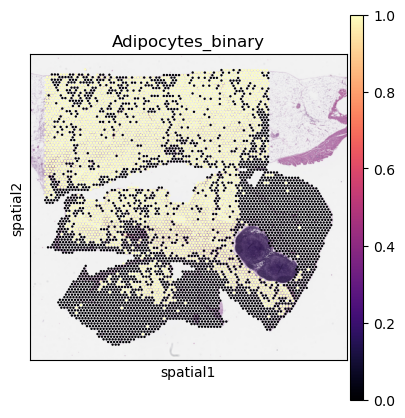

In [15]:
slide = select_slide(adata_vis, 'B006_3')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(slide.uns['mod']['factor_names'] + '_binary')[1],
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='B006_3', show = True
                 )

## Binary slides

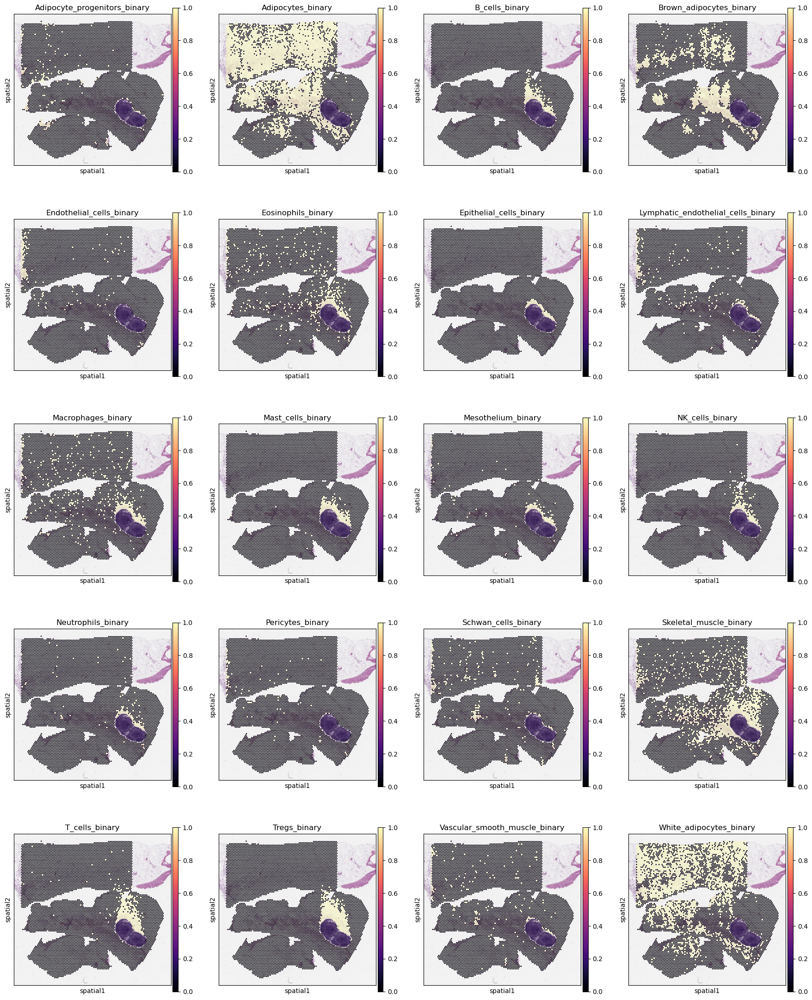

In [16]:
slide = select_slide(adata_vis, 'B006_3')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(np.append(slide.uns['mod']['factor_names'], 'White_adipocytes') + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='B006_3', show = True
                 )

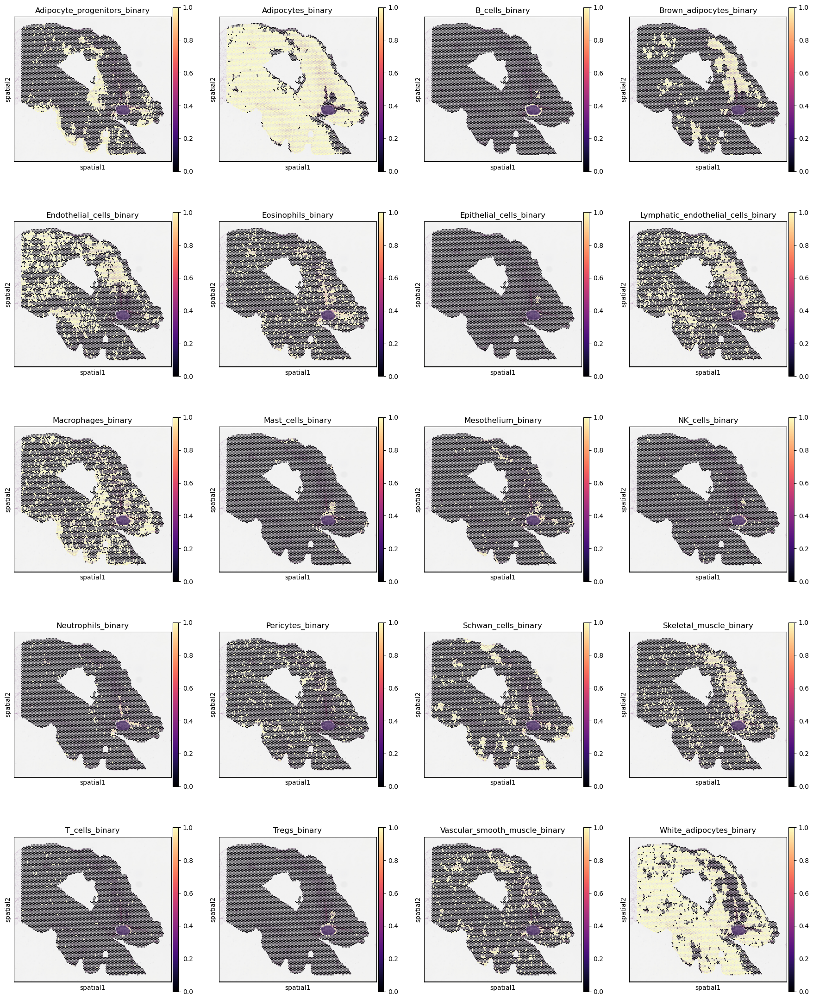

In [17]:
slide = select_slide(adata_vis, 'A021_3')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(np.append(slide.uns['mod']['factor_names'], 'White_adipocytes') + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='A021_3', show = True
                 )

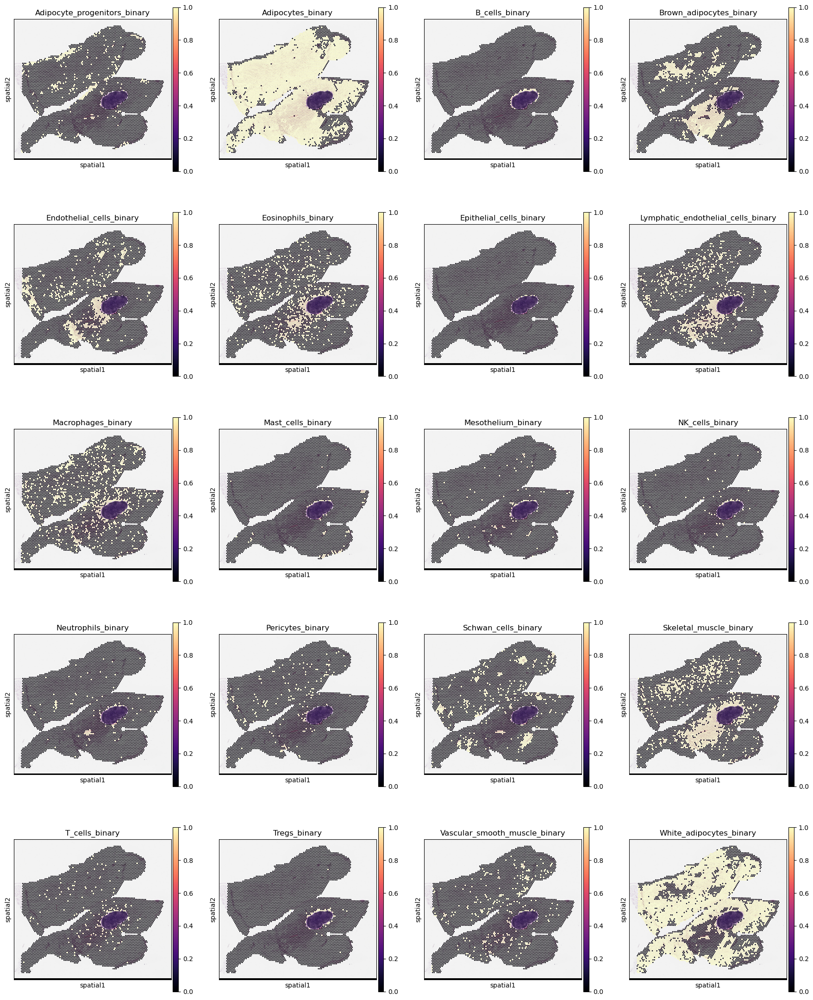

In [18]:
slide = select_slide(adata_vis, 'A006_3')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(np.append(slide.uns['mod']['factor_names'], 'White_adipocytes') + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='A006_3', show = True
                 )

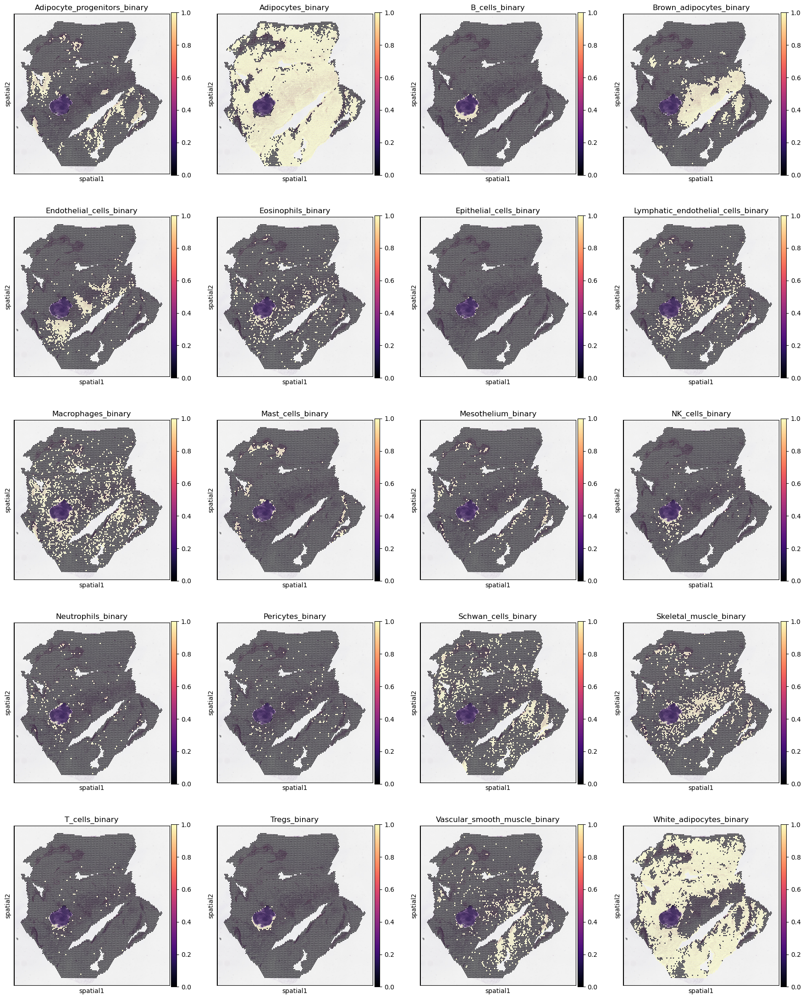

In [19]:
slide = select_slide(adata_vis, 'A041_6')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(np.append(slide.uns['mod']['factor_names'], 'White_adipocytes') + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='A041_6', show = True
                 )

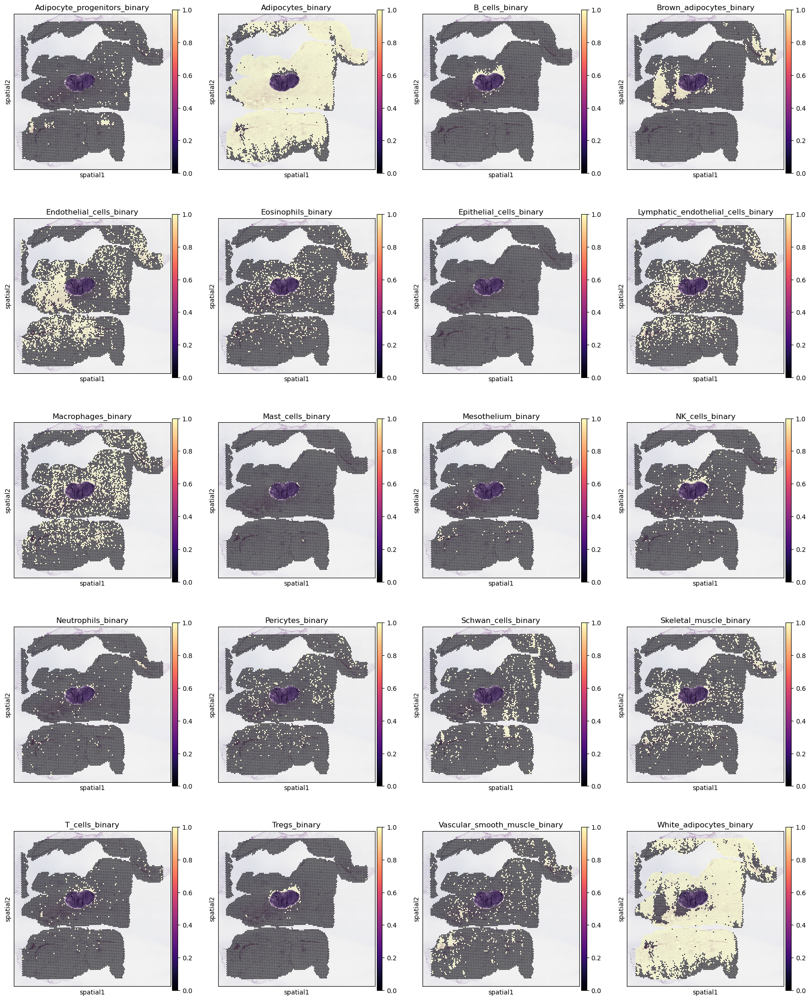

In [20]:
slide = select_slide(adata_vis, 'B041_6')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(np.append(slide.uns['mod']['factor_names'], 'White_adipocytes') + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='B041_6', show = True
                 )

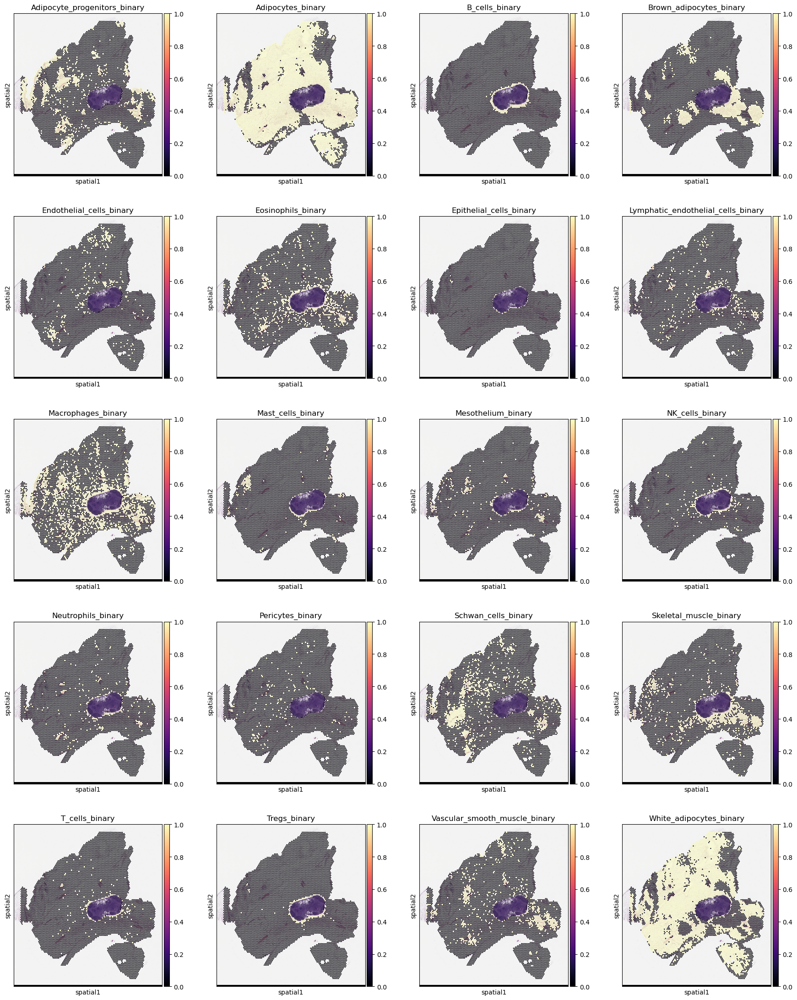

In [21]:
slide = select_slide(adata_vis, 'B021_6')
with plt.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(np.append(slide.uns['mod']['factor_names'], 'White_adipocytes') + '_binary'),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=1, library_id='B021_6', show = True
                 )

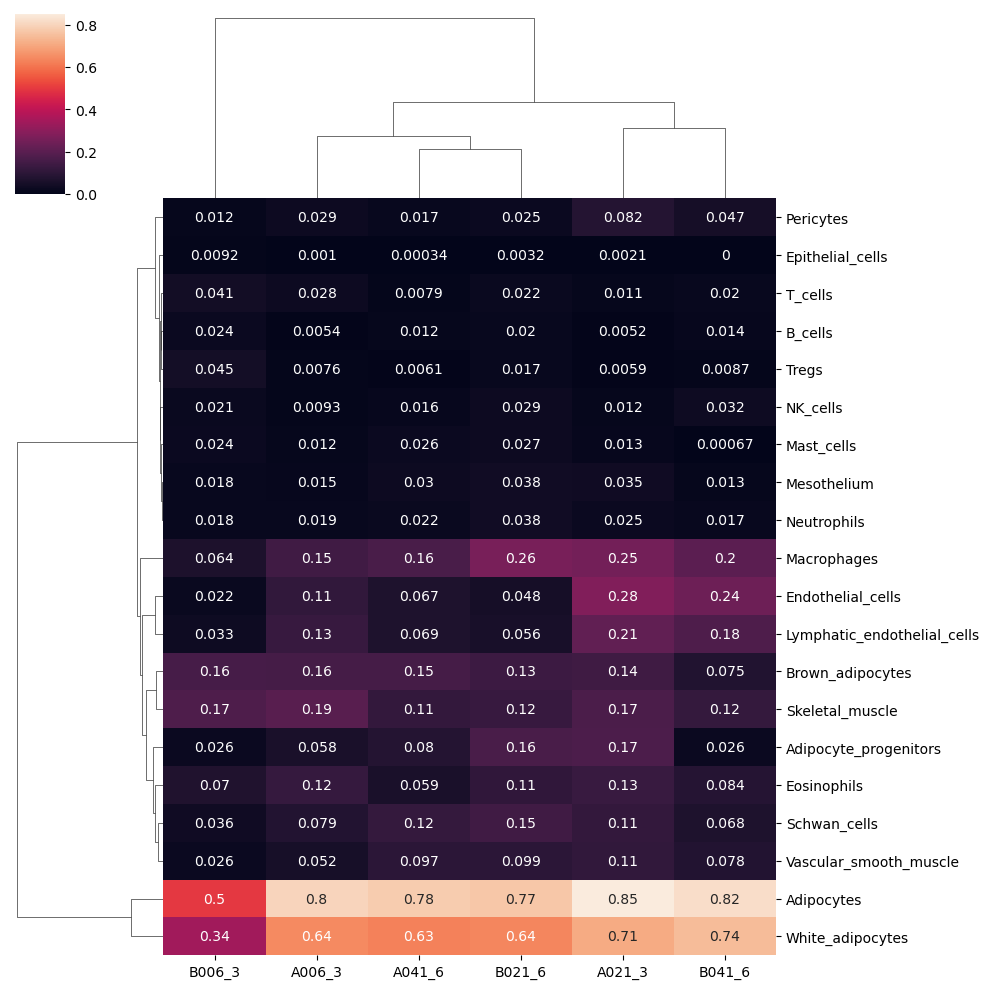

In [22]:
## make heatmap of deconvoluted_proportions_df
ax = sns.clustermap(deconvoluted_proportions_df, annot = True)

In [23]:
## cell type frequency across all slides
combined_counts = pd.concat(deconvoluted_counts.values())
combined_props = combined_counts.sum(axis = 0)/combined_counts.count(axis = 0)

In [24]:
df = pd.DataFrame(combined_props)
df.index = df.index.str.replace('q05cell_abundance_w_sf_','')

Text(0, 0.5, 'Proportion')

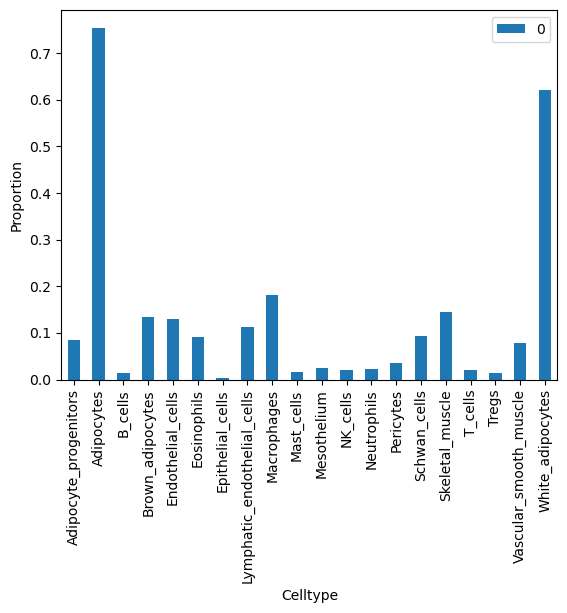

In [25]:
import matplotlib.pyplot as plt
 

# create stacked bar chart for monthly temperatures
df.plot(kind='bar', stacked=False)
 
# labels for x & y axis
plt.xlabel('Celltype')
plt.ylabel('Proportion')

In [26]:
## save the white adipocyte added object
adata_vis.write_h5ad(f"{run_name}/sp_with_white_adipocytes.h5ad")
adata_vis.obsm['q05_cell_abundance_w_sf'].drop(columns = 'sample').to_csv(f"{run_name}/q05_cell_abundance_w_sf_with_white_adipocytes.csv")